In [2]:
from pathlib import Path

# Our data folder 
data_home = Path('./PIG_ATL06')
# Create folder if it doesn't exist
data_home.mkdir(exist_ok=True)


In [3]:
import icepyx as ipx
short_name = 'ATL06'
spatial_extent = [76.376, 34.415, 83.273, 37.280]  # PIG
date_range = ['2020-10-14','2020-10-28']
region = ipx.Query(short_name, spatial_extent, date_range)


product:     ATL06
dates:       ['2020-10-14', '2020-10-28']
start time:  00:00:00
end time:    23:59:59
version:     004
extent:      ['bounding box', [76.376, 34.415, 83.273, 37.28]]

DATA:
('Number of available granules', 10)
('Average size of granules (MB)', 47.05630321503)
('Total size of all granules (MB)', 470.5630321503)


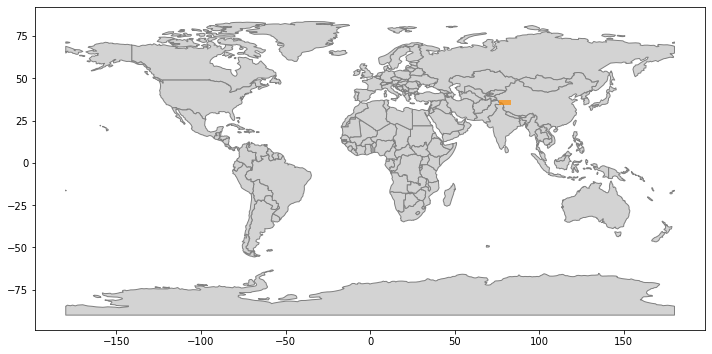

In [4]:
print('product:    ', region.dataset)
print('dates:      ', region.dates)
print('start time: ', region.start_time)
print('end time:   ', region.end_time)
print('version:    ', region.dataset_version)
print('extent:     ', region.spatial_extent)

print('\nDATA:')
print('\n'.join([str(item) for item in region.avail_granules().items()]))

region.visualize_spatial_extent()



In [5]:
name = '411795604'
email = 'xinluo_xin@163.com'

# Only download if data folder is empty
if not list(data_home.glob('*.h5')):
    region.earthdata_login(name, email)
    region.download_granules(data_home)


In [6]:
files = list(data_home.glob('*.h5'))

for f in files[:10]: print(f)
print('Total number of files:', len(files))


PIG_ATL06/processed_ATL06_20201020225537_04090902_004_01.h5
PIG_ATL06/processed_ATL06_20201027105446_05080906_004_01.h5
PIG_ATL06/processed_ATL06_20201024103725_04620906_004_01.h5
PIG_ATL06/processed_ATL06_20201024224714_04700902_004_01.h5
PIG_ATL06/processed_ATL06_20201016230355_03480902_004_01.h5
PIG_ATL06/processed_ATL06_20201019111125_03860906_004_01.h5
PIG_ATL06/processed_ATL06_20201015111944_03250906_004_01.h5
PIG_ATL06/processed_ATL06_20201028223857_05310902_004_01.h5
PIG_ATL06/processed_ATL06_20201023110305_04470906_004_01.h5
PIG_ATL06/processed_ATL06_20201028102907_05230906_004_01.h5
Total number of files: 10


In [7]:
!h5ls -r {files[0]}

ean Dataset {14795/Inf}
/gt2r/land_ice_segments/dem/geoid_h Dataset {14795/Inf}
/gt2r/land_ice_segments/fit_statistics Group
/gt2r/land_ice_segments/fit_statistics/dh_fit_dx Dataset {14795/Inf}
/gt2r/land_ice_segments/fit_statistics/dh_fit_dx_sigma Dataset {14795/Inf}
/gt2r/land_ice_segments/fit_statistics/dh_fit_dy Dataset {14795/Inf}
/gt2r/land_ice_segments/fit_statistics/h_expected_rms Dataset {14795/Inf}
/gt2r/land_ice_segments/fit_statistics/h_mean Dataset {14795/Inf}
/gt2r/land_ice_segments/fit_statistics/h_rms_misfit Dataset {14795/Inf}
/gt2r/land_ice_segments/fit_statistics/h_robust_sprd Dataset {14795/Inf}
/gt2r/land_ice_segments/fit_statistics/n_fit_photons Dataset {14795/Inf}
/gt2r/land_ice_segments/fit_statistics/n_seg_pulses Dataset {14795/Inf}
/gt2r/land_ice_segments/fit_statistics/sigma_h_mean Dataset {14795/Inf}
/gt2r/land_ice_segments/fit_statistics/signal_selection_source Dataset {14795/Inf}
/gt2r/land_ice_segments/fit_statistics/signal_selection_source_status Dataset

In [8]:
import pyproj
from astropy.time import Time

def gps2dyr(time):
    """Converte GPS time to decimal years."""
    return Time(time, format='gps').decimalyear


def orbit_type(time, lat, tmax=1):
    """Separate tracks into ascending and descending.
    
    Defines tracks as segments with time breaks > tmax,
    and tests whether lat increases or decreases w/time.
    """
    tracks = np.zeros(lat.shape)  # generate track segment
    tracks[0:np.argmax(np.abs(lat))] = 1  # set values for segment
    is_asc = np.zeros(tracks.shape, dtype=bool)  # output index array

    # Loop trough individual secments
    for track in np.unique(tracks):
    
        i_track, = np.where(track == tracks)  # get all pts from seg
    
        if len(i_track) < 2: continue
    
        # Test if lat increases (asc) or decreases (des) w/time
        i_min = time[i_track].argmin()
        i_max = time[i_track].argmax()
        lat_diff = lat[i_track][i_max] - lat[i_track][i_min]
    
        # Determine track type
        if lat_diff > 0:  is_asc[i_track] = True
    
    return is_asc


def transform_coord(proj1, proj2, x, y):
    """Transform coordinates from proj1 to proj2 (EPSG num).

    Example EPSG projections:
        Geodetic (lon/lat): 4326
        Polar Stereo AnIS (x/y): 3031
        Polar Stereo GrIS (x/y): 3413
    """
    # Set full EPSG projection strings
    proj1 = pyproj.Proj("+init=EPSG:"+str(proj1))
    proj2 = pyproj.Proj("+init=EPSG:"+str(proj2))
    return pyproj.transform(proj1, proj2, x, y)  # convert

In [9]:
import h5py
import numpy as np

def read_atl06(fname, outdir='data', bbox=None):
    """Read one ATL06 file and output 6 reduced files. 
    
    Extract variables of interest and separate the ATL06 file 
    into each beam (ground track) and ascending/descending orbits.
    """

    # Each beam is a group
    group = ['/gt1l', '/gt1r', '/gt2l', '/gt2r', '/gt3l', '/gt3r']

    # Loop trough beams
    for k, g in enumerate(group):
    
        #-----------------------------------#
        # 1) Read in data for a single beam #
        #-----------------------------------#
        
        data = {}
    
        try:
            # Load vars into memory (include as many as you want)
            with h5py.File(fname, 'r') as fi:
                
                data['lat'] = fi[g+'/land_ice_segments/latitude'][:]
                data['lon'] = fi[g+'/land_ice_segments/longitude'][:]
                data['h_li'] = fi[g+'/land_ice_segments/h_li'][:]
                data['s_li'] = fi[g+'/land_ice_segments/h_li_sigma'][:]
                data['t_dt'] = fi[g+'/land_ice_segments/delta_time'][:]
                data['q_flag'] = fi[g+'/land_ice_segments/atl06_quality_summary'][:]
                data['s_fg'] = fi[g+'/land_ice_segments/fit_statistics/signal_selection_source'][:]
                data['snr'] = fi[g+'/land_ice_segments/fit_statistics/snr_significance'][:]
                data['h_rb'] = fi[g+'/land_ice_segments/fit_statistics/h_robust_sprd'][:]
                data['dac'] = fi[g+'/land_ice_segments/geophysical/dac'][:]
                data['f_sn'] = fi[g+'/land_ice_segments/geophysical/bsnow_conf'][:]
                data['dh_fit_dx'] = fi[g+'/land_ice_segments/fit_statistics/dh_fit_dx'][:]
                data['tide_earth'] = fi[g+'/land_ice_segments/geophysical/tide_earth'][:]
                data['tide_load'] = fi[g+'/land_ice_segments/geophysical/tide_load'][:]
                data['tide_ocean'] = fi[g+'/land_ice_segments/geophysical/tide_ocean'][:]
                data['tide_pole'] = fi[g+'/land_ice_segments/geophysical/tide_pole'][:]
                
                rgt = fi['/orbit_info/rgt'][:]                           # single value
                t_ref = fi['/ancillary_data/atlas_sdp_gps_epoch'][:]     # single value
                beam_type = fi[g].attrs["atlas_beam_type"].decode()      # strong/weak (str)
                spot_number = fi[g].attrs["atlas_spot_number"].decode()  # number (str)
                
        except:
            print('skeeping group:', g)
            print('in file:', fname)
            continue
            
        #---------------------------------------------#
        # 2) Filter data according region and quality #
        #---------------------------------------------#
        
        # Select a region of interest
        if bbox:
            lonmin, lonmax, latmin, latmax = bbox
            bbox_mask = (data['lon'] >= lonmin) & (data['lon'] <= lonmax) & \
                        (data['lat'] >= latmin) & (data['lat'] <= latmax)
        else:
            bbox_mask = np.ones_like(data['lat'], dtype=bool)  # get all
            
        # Only keep good data (quality flag + threshold + bbox)
        mask = (data['q_flag'] == 0) & (np.abs(data['h_li']) < 10e3) & (bbox_mask == 1)
        
        # If no data left, skeep
        if not any(mask): continue
        
        # Update data variables
        for k, v in data.items(): data[k] = v[mask]
            
        #----------------------------------------------------#
        # 3) Convert time, separate tracks, reproject coords #
        #----------------------------------------------------#
        
        # Time in GPS seconds (secs sinde Jan 5, 1980)
        t_gps = t_ref + data['t_dt']

        # Time in decimal years
        t_year = gps2dyr(t_gps)

        # Determine orbit type
        is_asc = orbit_type(t_year, data['lat'])
        
        # Geodetic lon/lat -> Polar Stereo x/y
        x, y = transform_coord(4326, 3031, data['lon'], data['lat'])
        
        data['x'] = x
        data['y'] = y
        data['t_gps'] = t_gps
        data['t_year'] = t_year
        data['is_asc'] = is_asc
        
        #-----------------------#
        # 4) Save selected data #
        #-----------------------#
        
        # Define output dir and file
        outdir = Path(outdir)    
        fname = Path(fname)
        outdir.mkdir(exist_ok=True)
        outfile = outdir / fname.name.replace('.h5', '_' + g[1:] + '.h5')
        
        # Save variables
        with h5py.File(outfile, 'w') as fo:
            for k, v in data.items(): fo[k] = v
            print('out ->', outfile)

In [10]:
!python system-status.py


I am currently running on Darwin version 20.3.0.  
This system is named luoxins-MacBook-Pro.local 
It has 8 CPU cores.  
It has 16 Gigabytes of RAM.  
Current disk_percent is 4.1 percent.  
Current CPU utilization is 26.7 percent.  
Current memory utilization is 66.5 percent. 
it's running since Tuesday 20. April 2021. 



In [13]:
# outdir = Path.home()
outdir = Path('./PIG_ATL06/subset')

njobs = 8

bbox = None  #[-1124782, 81623, -919821, -96334]  # Kamb bounding box

outdir.mkdir(exist_ok=True)

if njobs == 1:
    print('running in serial ...')
    [read_atl06(f, outdir, bbox) for f in files]

else:
    print('running in parallel (%d jobs) ...' % njobs)
    from joblib import Parallel, delayed
    Parallel(n_jobs=njobs, verbose=5)(delayed(read_atl06)(f, outdir, bbox) for f in files)


running in parallel (8 jobs) ...
[Parallel(n_jobs=8)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done   4 out of  10 | elapsed:    2.9s remaining:    4.3s
[Parallel(n_jobs=8)]: Done   7 out of  10 | elapsed:    3.0s remaining:    1.3s
[Parallel(n_jobs=8)]: Done  10 out of  10 | elapsed:    3.7s remaining:    0.0s
[Parallel(n_jobs=8)]: Done  10 out of  10 | elapsed:    3.7s finished


In [14]:
# outfiles = !ls {outdir}/*.h5
outfiles = list(outdir.glob('*.h5'))

for f in outfiles[:10]: print(f)
print('Total number of files:', len(outfiles))



PIG_ATL06/subset/processed_ATL06_20201028223857_05310902_004_01_gt3r.h5
PIG_ATL06/subset/processed_ATL06_20201020225537_04090902_004_01_gt3l.h5
PIG_ATL06/subset/processed_ATL06_20201020225537_04090902_004_01_gt2l.h5
PIG_ATL06/subset/processed_ATL06_20201024224714_04700902_004_01_gt1r.h5
PIG_ATL06/subset/processed_ATL06_20201028223857_05310902_004_01_gt2r.h5
PIG_ATL06/subset/processed_ATL06_20201024224714_04700902_004_01_gt3r.h5
PIG_ATL06/subset/processed_ATL06_20201020225537_04090902_004_01_gt1l.h5
PIG_ATL06/subset/processed_ATL06_20201024224714_04700902_004_01_gt2r.h5
PIG_ATL06/subset/processed_ATL06_20201028223857_05310902_004_01_gt1r.h5
PIG_ATL06/subset/processed_ATL06_20201023110305_04470906_004_01_gt3l.h5
Total number of files: 60


In [15]:
!h5ls -r {outfiles[0]}


/                        Group
/dac                     Dataset {1781}
/dh_fit_dx               Dataset {1781}
/f_sn                    Dataset {1781}
/h_li                    Dataset {1781}
/h_rb                    Dataset {1781}
/is_asc                  Dataset {1781}
/lat                     Dataset {1781}
/lon                     Dataset {1781}
/q_flag                  Dataset {1781}
/s_fg                    Dataset {1781}
/s_li                    Dataset {1781}
/snr                     Dataset {1781}
/t_dt                    Dataset {1781}
/t_gps                   Dataset {1781}
/t_year                  Dataset {1781}
/tide_earth              Dataset {1781}
/tide_load               Dataset {1781}
/tide_ocean              Dataset {1781}
/tide_pole               Dataset {1781}
/x                       Dataset {1781}
/y                       Dataset {1781}


In [20]:
import h5py
import numpy as np
import dask.dataframe as dd
import pandas as pd
import warnings
warnings.filterwarnings("ignore")

def read_h5(fname, vnames=[]):
    """Read a list of vars [v1, v2, ..] -> 2D."""
    with h5py.File(fname, 'r') as f:
        return np.column_stack([f[v][()] for v in vnames])
    
# Get list of files to plot
#files = list(Path('/home/jovyan/tutorial-data/gridding-time-series/org').glob('*.h5'))
files = list(outdir.glob('*.h5'))

# Variables we want to plot
#vnames = ['lon', 'lat', 'h_elv']
vnames = ['x', 'y', 'h_li']

# List with one dataframe per file
# dfs = [dd.from_array(read_h5(f, vnames), columns=vnames) for f in files]
dfs = [pd.DataFrame(read_h5(f, vnames), columns=vnames) for f in files]


# Single parallel dataframe (larger than memory)
# df = dd.concat(dfs)
df = pd.concat(dfs)

print('Number of files:', len(files))
print('Number of points:', len(df))
print(df.head())

Number of files: 60
Number of points: 279825
              x             y         h_li
0  2.308872e+07  4.921151e+06  5671.765137
1  2.320760e+07  4.958687e+06  5284.588379
2  2.322202e+07  4.963252e+06  5689.688477
3  2.322211e+07  4.963280e+06  5685.199219
4  2.322220e+07  4.963307e+06  5683.449219


<AxesSubplot:xlabel='x', ylabel='y'>

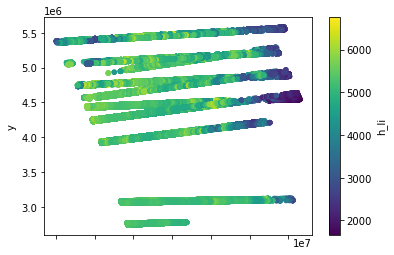

In [23]:
df.plot.scatter(x='x', y='y', c='h_li', colormap='viridis')


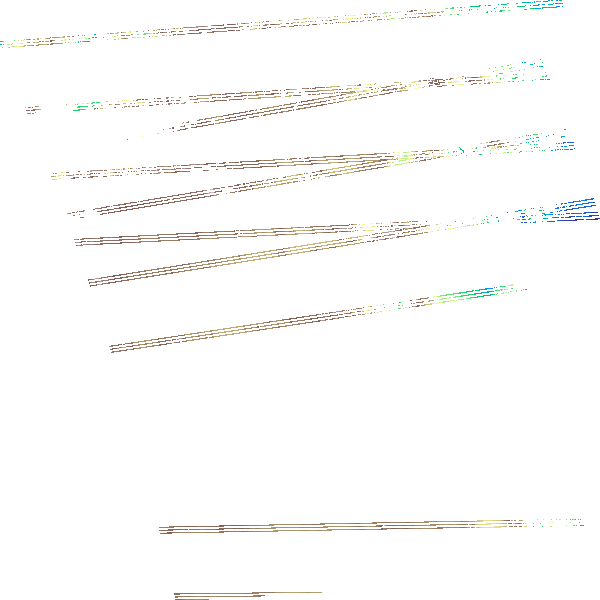

In [33]:
import datashader as ds
import datashader.transfer_functions as tf
from matplotlib.cm import terrain as cmap

#df = dd.read_csv(str(outdir)+'/*.csv')

pts = ds.Canvas(plot_width=600, plot_height=600)
#agg = pts.points(df, 'lon', 'lat', ds.mean('h_elv'))
agg = pts.points(df, 'x', 'y', ds.mean('h_li'))
img = tf.shade(agg, cmap=cmap, how='linear')
img
